# SEP 775 Assignment 2

## Task2: Seq2Seq Neural Machine Translation with Attention

In [221]:
import torch.nn as nn
import torch
import numpy as np
from torch.utils.data import TensorDataset, DataLoader
import pandas as pd
import torch.nn.functional as F
from torch.nn.utils.rnn import pad_packed_sequence, pack_padded_sequence
from collections import Counter, namedtuple
from typing import List, Tuple, Dict, Set, Union
import time
import tqdm
from nltk.translate.bleu_score import corpus_bleu
import math
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Read English sentences from the sentence pairs
with open('small_vocab_en.csv','r') as file:
    file_sents = []
    for i in file:
        i = i.replace('\n','')
        file_sents.append(i)


In [3]:
# Only take the first 50000 sentences to save time for training/testing
en_sents = np.array(file_sents)[:50000]

In [4]:
en_sents

array(['new jersey is sometimes quiet during autumn , and it is snowy in april .',
       'the united states is usually chilly during july , and it is usually freezing in november .',
       'california is usually quiet during march , and it is usually hot in june .',
       ...,
       'china is usually warm during september , and it is usually nice in january .',
       'india is usually freezing during december , but it is never beautiful in spring .',
       'she wanted to go to new jersey last july .'], dtype='<U102')

In [5]:
# Read French sentences from the sentence pairs
with open('small_vocab_fr.csv',encoding='utf-8') as file:
    file_sents = []
    i = 0
    for sent in file:
        if i == 0:
            i += 1
            continue
        splitted_sent = sent.replace('\n','').split(',')
        merged_sen = ''
        for s in splitted_sent:
            if not ((s == '') or ('\n' in s)):
                merged_sen += s+','
                
        file_sents.append(merged_sen[:-1])

In [6]:
fr_sents = np.array(file_sents)[:50000]

In [7]:
# Define tokens for punctuation marks
def create_punct_tokens():
    """
    Generate and return a tokenized dictionary with punctuation marks as keys and tokens as values
    """
    punct_token = dict()
    punct_token['.'] = '<PERIOD>'
    punct_token[','] = '<COMMA>'
    punct_token['"'] = 'DOUBLE_QUOTE'
    punct_token[';'] = '<SEMICOLON>'
    punct_token['!'] = 'EXCLAIMATION_MARK'
    punct_token['?'] = 'QUESTION_MARK'
    punct_token['('] = 'LEFT_BRACKET'
    punct_token[')'] = 'RIGHT_BRACKET'
    punct_token['-'] = '<DASH>'
    punct_token['&'] = '<AND>'
    punct_token['\n'] = 'NEW_LINE_CHAR'
    return punct_token

In [8]:
def create_vocab_lookup_table(corpus):
    """
    Function to generate lookup tables for vocabulary
    
    Parameters:
    corpus: The corpus text split into words
    
    Output:
    A tuple of dictionaries (word_to_int, int_to_word)
    """
    word_freq = Counter(corpus)
    # Sort the words by their number of appearances in the corpus
    sorted_vocab = sorted(word_freq, key=word_freq.get, reverse=True)
    int_to_word = {idx:word for idx, word in enumerate(sorted_vocab)}
    word_to_int = {word:idx for idx, word in int_to_word.items()}
    
    # return tuple
    return (word_to_int, int_to_word)

In [9]:
def pad_sents(sents, pad_token, tgt_start_token, tgt_end_token, is_tgt:bool):
    """ 
    Function to pad list of sentences according to the longest sentence in the batch
    to the end of each sentence.
    
    Parameters:
    sents (list[list[str]]): list of sentences, where each sentence
                                    is represented as a list of words
    pad_token (str): padding token to be added at the end of each sentence
    tgt_start_token/tgt_end_token (str): the token that will be placed at the head/tail of the target sentences
    is_tgt (bool): if the sentences will be used as target(True) or source(False)
    
    Output:
    sents_padded: (list[list[str]]): list of sentences where sentences shorter
    than the longest-length sentence are padded out with the pad_token, so that
    each sentences in the batch will have the same length.
    """
    sents_padded = []

    lengths = [len(s) for s in sents]
    longest_len = max(lengths)

    for sent in sents:
        if is_tgt:
            sents_padded.append([tgt_start_token]+sent)
        else:
            sents_padded.append(sent)
        
        for i in range(longest_len-len(sent)):
            sents_padded[-1].append(pad_token)
        
        if is_tgt:
            sents_padded[-1].append(tgt_end_token)

    return sents_padded

In [10]:
def preprocess_and_save_sents(raw_sents, def_punct_tokens, vocab_lookup_table_gen, is_tgt:bool):
    """
    Function to preprocess the corpus data that has been splitted into sentences (list/array(str))
    
    Parameters:
    raw_sents: Raw sentences in form of list(str)
    def_punct_tokens: Function that defines the punctuations tokens
    vocab_lookup_table_gen: Funtion that generates look up table for the vocab
    is_tgt (bool): if the sentences will be used as target(True) or source(False)
    
    Output:
    int_corpus: list of ints converted from the corpus
    word_to_int: dict of look up table from word to int
    int_to_word: dict of look up table from int to word
    punct_token: dict of look up table for punctuations
    """
    
    # Turn all corpus text to lower case, turn punctuations into tokens
    # and split by space 
    sents_lower = [sent.lower() for sent in raw_sents]
    
    punct_tokens = create_punct_tokens()
    for punct, token in punct_tokens.items():
        punct_tokened_sents = [sent.replace(punct, ' {} '.format(token)) for sent in sents_lower]
    
    corpus_splitted = []
    for sent in punct_tokened_sents:
        corpus_splitted += sent.split()
    
    # Add a padding token into the look up table other than the vocab in case it will be needed
    # as a space holder for different length of sentences later
    if is_tgt:
        corpus_splitted += ['<PAD>', '<s>', '</s>']
    else:
        corpus_splitted.append('<PAD>')
    
    word_to_int, int_to_word = vocab_lookup_table_gen(corpus_splitted)
    
    # split each sentence to create a corpus in form of list(list(str))
    splitted_sents = []
    for sent in punct_tokened_sents:
        splitted_sents.append(sent.split())
    # Pad the sentences to the same length
    if is_tgt:
        padded_sents = pad_sents(splitted_sents,'<PAD>', '<s>', '</s>', True)
    else:
        padded_sents = pad_sents(splitted_sents,'<PAD>',None, None, False)
    # convert sequences of str to sequences of int 
    int_sents = []
    for sent in padded_sents:
        int_sents.append([word_to_int[word] for word in sent])
    return (int_sents, word_to_int, int_to_word, punct_tokens)

In [11]:
# Preprocess the raw English sentences
en_int_sents, enword_to_int, int_to_enword, punct_tokens= preprocess_and_save_sents(en_sents, create_punct_tokens,
                                                                                    create_vocab_lookup_table, True)

In [12]:
len(en_int_sents)

50000

In [22]:
# number of unique words in the English vocab
len(enword_to_int.keys())

230

In [13]:
# Preprocess the raw French sentences
fr_int_sents, frword_to_int, int_to_frword, _ = preprocess_and_save_sents(fr_sents, create_punct_tokens,
                                                                          create_vocab_lookup_table, False)

In [21]:
# number of unique words in the English vocab
len(frword_to_int.keys())

345

In [14]:
len(fr_int_sents)

50000

In [15]:
# Split train and test sets
train_en_int_sents = en_int_sents[:40000]
test_en_int_sents = en_int_sents[40000:]
train_fr_int_sents = fr_int_sents[:40000]
test_fr_int_sents = fr_int_sents[40000:]

In [16]:
def padded_sents_lengths(padded_sents, vocab_to_int, pad_token):
    """
    Function to compute actual lengths of padded sentences in their numerical form
    
    Parameters:
    padded_sents list(list(int)): padded sentences in their numerical(int) form
    vocab_to_int dict(str:int): Look up table from word of the sentences' vocab to int
    pad_token str: the token that was used for padding the sentences
    
    Output: list(int) containing the actual lengths of the padded sentences
    """
    origin_sents = [list(filter((vocab_to_int[pad_token]).__ne__, sent)) for sent in padded_sents]
    return [len(s) for s in origin_sents]

In [17]:
class ModelEmbeddings(nn.Module):
    """
    Class that converts input words (in numerical(int) form) to their embeddings.
    """
    def __init__(self, embed_size, src_vocab, tgt_vocab):
        """
        Function to initialize the encoder and decoder Embedding layers.
        
        Parameters:
        embed_size: word embeddings' dimension
        src_vocab/tgt_vocab: Vocabulary(including the padding token) of src/target language 
        in form of dictionary where keys are unique words and values are their corresponding int
        """
        super(ModelEmbeddings, self).__init__()
        self.embed_size = embed_size

        src_pad_token_idx = src_vocab['<PAD>']
        tgt_pad_token_idx = tgt_vocab['<PAD>']

        self.source = nn.Embedding(len(src_vocab.keys()),self.embed_size,padding_idx=src_pad_token_idx)
        self.target = nn.Embedding(len(tgt_vocab.keys()),self.embed_size,padding_idx=tgt_pad_token_idx)


In [162]:
# Define a type for hypotheses to be used later during beam search
Hypothesis = namedtuple('Hypothesis', ['value', 'score'])

class NMT(nn.Module):
    """ 
    Class for Neural Machine Translation Model with optional Global Multiplicative Attention
    """
    def __init__(self, embed_size, hidden_size, src_vocab_to_int, tgt_vocab_to_int, 
                 int_to_src_vocab, int_to_tgt_vocab, use_attention:bool):
        """ 
        Initializer for NMT Model.
        
        Parameters:
        embed_size int: Word embeddings' dimension 
        hidden_size int: Hidden states' dimension 
        src_vocab_to_int dict(str:int): Look up table from word of the source sentences' vocab to int
        tgt_vocab_to_int dict(str:int): Look up table from word of the target sentences' vocab to int
        int_to_src_vocab dict(int:str): Look up table from int to word of the source sentences' vocab
        int_to_tgt_vocab dict(int:str): Look up table from int to word of the target sentences' vocab
        use_attention bool: whether the NMT model will use attention mechanism or not
        """
        super(NMT, self).__init__()
        # define class variables and embedding layers
        self.model_embeddings = ModelEmbeddings(embed_size, src_vocab_to_int, tgt_vocab_to_int)
        self.hidden_size = hidden_size
        self.src_vocab_to_int = src_vocab_to_int
        self.tgt_vocab_to_int = tgt_vocab_to_int
        self.int_to_src_vocab = int_to_src_vocab
        self.int_to_tgt_vocab = int_to_tgt_vocab
        self.use_attention = use_attention

        # define torch.nn layers needed
        self.encoder = nn.LSTM(embed_size, hidden_size)
        self.decoder = nn.LSTMCell(embed_size, hidden_size)
        self.h_projection = nn.Linear(hidden_size, hidden_size, bias=False)
        self.c_projection = nn.Linear(hidden_size, hidden_size, bias=False)
        
        if use_attention:
            self.att_projection = nn.Linear(hidden_size, hidden_size, bias=False)
            self.combined_output_projection = nn.Linear(2*hidden_size, hidden_size, bias=False)
        
        self.target_vocab_projection = nn.Linear(hidden_size, len(tgt_vocab_to_int.keys()), bias=False)


    def forward(self, src_int_sents: List[List[int]], tgt_int_sents: List[List[int]]) -> torch.Tensor:
        """ 
        Function to take a batch of source and target sentences, compute the log-likelihood of
        target sentences with the language model learned by the NMT.
        
        Parameters
        src_int_sents list(list(int)): list of source sentences in their numerical(int) form
        tgt_int_sents list(list(int)): list of target sentence in their numerical(int) form, assuming 
                                       wrapped by `<s>` and `</s>`
                                       
        Output:
        scores torch.Tensor: a tensor of shape (batch_size, ) recording the log-likelihoods of generating the real target sentence for
                             each sample in the input sentence batch.
        """
        # Convert list of lists into tensors
        src_tensor = torch.LongTensor(src_int_sents).T  # Tensor: (src_len, b)
        tgt_tensor = torch.LongTensor(tgt_int_sents).T   # Tensor: (tgt_len, b)
        
        src_lengths = padded_sents_lengths(src_int_sents, self.src_vocab_to_int, '<PAD>')
        
        enc_hiddens, dec_init_state = self.encode(src_tensor, src_lengths)
        combined_outputs = self.decode(enc_hiddens, dec_init_state, tgt_tensor)   # (tgt_len-1, b, h)
        log_prob = F.log_softmax(self.target_vocab_projection(combined_outputs), dim=-1)   # (tgt_len-1, b, |tgt vocab|)

        # Zero out, probabilities for which we have nothing in the target text
        target_masks = (tgt_tensor != self.tgt_vocab_to_int['<PAD>']).float()

        # Compute probability of generating true target words
        # indexing with tgt_tensor[1:] because the first row is filled with '<s>'
        # tgt_tensor[1:].unsqueeze(-1) -> (tgt_len-1, b, 1)
        # predict_gold_words_logprob -> (tgt_len-1, b)
        predict_gold_words_logprob = torch.gather(log_prob, index=tgt_tensor[1:].unsqueeze(-1), dim=-1).squeeze(-1) * target_masks[1:]
        scores = predict_gold_words_logprob.sum(dim=0) # (b), one score for each batch
        return scores


    def encode(self, src_tensor: torch.Tensor, src_lengths: List[int]) -> Tuple[torch.Tensor, Tuple[torch.Tensor, torch.Tensor]]:
        """ 
        Function to apply the encoder LSTM layer to source sentences to obtain encoder hidden states,
        take the final states of the encoder, and linearly project the final states to get the initial states for decoder.
        
        Parameters:
        src_tensor torch.Tensor: Tensor of padded source sentences with shape (src_len, batch_size). 
                                 src_len = maximum source sentence length. Assuming the sentences have 
                                 already been sorted for longest to shortest by lengths.
        src_lengths list(int): List of actual lengths of the source sentences in the batch
        
        Outputs:
        enc_hiddens torch.Tensor: Tensor of hidden states of encoder with shape (batch_size, src_len, hidden_size). 
        dec_init_state tuple(Tensor, Tensor): Tuple of tensors containing the decoder's initial
                                              hidden and cell states of shape (batch_size, hidden_size).
        """
        # Get embeddings for source sentences
        src_embeds = self.model_embeddings.source(src_tensor)   # (src_len, b, embed_size)
        # Go through encoder LSTM
        # enc_hiddens -> (src_len, b, h), last_hidden, last_cell -> (b, h), (b, h)
        enc_hiddens, (last_hidden, last_cell) = self.encoder(pack_padded_sequence(src_embeds, src_lengths))   
        enc_hiddens = pad_packed_sequence(enc_hiddens)[0].permute(1, 0, 2)   # (b, src_len, h)
        #print("Last encoder hidden size: "+str(last_hidden.size()))
        #print("Last encoder cell size: "+str(last_cell.size()))
        init_decoder_hidden = self.h_projection(last_hidden).squeeze(0)   # (b, h)
        init_decoder_cell = self.c_projection(last_cell).squeeze(0)   # (b, h)
        dec_init_state = (init_decoder_hidden, init_decoder_cell)

        return enc_hiddens, dec_init_state


    def decode(self, enc_hiddens: torch.Tensor, dec_init_state: Tuple[torch.Tensor, torch.Tensor], 
               tgt_tensor: torch.Tensor) -> torch.Tensor:
        """
        Function to compute combined output vectors for a batch.
        
        Parameters:
        enc_hiddens torch.Tensor: Hidden states from encoder with shape (batch_size, src_len, hidden_size)
        dec_init_state tuple(Tensor, Tensor): Initial hidden and cell states for decoder LSTM layer 
                                              of shape (batch_size, hidden_size)
        tgt_tensor torch.Tensor: padded target sentences (tgt_len, batch_size).
                                 tgt_len = maximum target sentence length
        
        Outputs:
        combined_outputs (Tensor): Combined output tensor with shape (tgt_len-1, batch_size, hidden_size)
        """
        # Get rid of the </s> token at the end of target sentences.
        tgt_tensor = tgt_tensor[:-1]

        # Initialize the decoder state (hidden and cell)
        dec_state = dec_init_state

        # Get batch_size from the enc_hiddens tensor
        batch_size = enc_hiddens.size(0)

        # Initialize a list we will use to record the output o_t on each step
        outputs = []
        
        # When using attention mechanism, need to linearly project the enc_hiddens since doing multiplicative attention
        if self.use_attention:
            enc_hiddens_proj = self.att_projection(enc_hiddens)   # (b, src_len, h)
        
        # Embed the target sentences
        tgt_embeds = self.model_embeddings.target(tgt_tensor)   # (tgt_len-1, b, embed_size)
        
        for i in range(tgt_embeds.size(0)):
            if self.use_attention:
                dec_state, o_t, _ = self.step(tgt_embeds[i], dec_state, enc_hiddens, enc_hiddens_proj)
                #print("Decoder output size: "+str(o_t.size()))
                #print("Last decoder hidden size: "+str(dec_state[0].size()))
            else:
                dec_state = self.decoder(tgt_embeds[i], dec_state)
                dec_hidden,_ = dec_state
                #print("Decoder hidden size: "+str(dec_state[0].size()))
                # take the last decoder hidden state and 
                # apply tanh on it to get current step's output of decoder
                o_t = torch.tanh(dec_hidden)
                #print("Decoder output size: "+str(o_t.size()))
            outputs.append(o_t)
            
        combined_outputs = torch.stack(outputs)   # (tgt_len-1, b, h)

        return combined_outputs


    def step(self, curr_tgt_embed: torch.Tensor, dec_state: Tuple[torch.Tensor, torch.Tensor],
             enc_hiddens: torch.Tensor, enc_hiddens_proj: torch.Tensor) -> Tuple[Tuple, torch.Tensor, torch.Tensor]:
        """ 
        Function to compute one step forward of the decoder LSTM layer with the attention mechanism.
        
        Parameters:
        curr_tgt_embed torch.Tensor: tensor of current words' embeddings of each batch with shape (batch_size, embed_size), 
                                     which will be used as the input to the decoder,
        dec_state tuple(Tensor, Tensor): Tuple of tensors both with shape (batch_size, hidden_size).
                                         First entry is previous decoder's hidden state, 
                                         second entry is previous decoder's  cell state.
        enc_hiddens torch.Tensor: Tensor that contains encoder's hidden states with shape (batch_size, src_len, hidden_size)
        enc_hiddens_proj torch.Tensor: Linearly projected encoder hidden states Tensor with shape (b, src_len, h)
        
        Outputs
        dec_state tuple(Tensor, Tensor): Tuple of tensors both shape (batch_size, hidden_size)
                                         First entry is decoder's new hidden state, 
                                         second entry is decoder's new cell state.
        o_t torch.Tensor: Tensor that contains the combined output at timestep t with shape (batch_size, hidden_size)
        e_t torch.Tensor: Tensor of shape (batch_size, src_len) which contains the attention scores distribution.
        """
        # go through decoder LSTM layer
        dec_state = self.decoder(curr_tgt_embed, dec_state)
        dec_hidden, dec_cell = dec_state   # (b, h), (b, h)
        # compute attention scores
        e_t = torch.bmm(enc_hiddens_proj, dec_hidden.unsqueeze(-1)).squeeze(-1)   # (b, src_len)
        
        # compute attention distribution
        alpha_t = F.softmax(e_t, dim=-1)   # (b, src_len)
        # compute weighted sum of enc_hiddens
        a_t = torch.bmm(alpha_t.unsqueeze(1), enc_hiddens).squeeze(1)   # (b, h)
        comb_out_t = torch.cat((dec_hidden, a_t), 1)   # (b, 2h)
        v_t = self.combined_output_projection(comb_out_t)   # (b, h)
        o_t = torch.tanh(v_t)

        return dec_state, o_t, e_t

     
    def beam_search(self, src_int_sent: List[int], beam_size: int = 5, max_decoding_time_step: int = 70) -> List[
        Hypothesis]:
        """ 
        Function to perform beam search using a single source sentence, producing translations in the target language.
        
        Parameters:
        src_int_sent list(int): a single source sentence in its numerical(int) form
        beam_size int: beam size for the search
        max_decoding_time_step int: max number of time steps to unroll the decoder LSTM
        
        Outputs:
        completed_hypotheses list(Hypothesis): a list of Hypothesis, each Hypothesis includes two fields:
                                               value list(str): the decoded translation, in form of a list of string, 
                                                                each string is a word
                                               score float: the log-likelihood of the target sentence
        """
        src_tensor = torch.LongTensor([src_int_sent]).T
        src_removed_pad = list(filter((self.src_vocab_to_int['<PAD>']).__ne__, src_int_sent)) 
        
        # encode the source sentence
        src_encodings, dec_init_states = self.encode(src_tensor, [len(src_removed_pad)])
        
        # Linear projection for src_encodings if using attention
        if self.use_attention:
            src_enc_attn_proj = self.att_projection(src_encodings)

        last_dec_state = dec_init_states
        
        # get id for the end-of-string token
        eos_id = self.tgt_vocab_to_int['</s>']
        # initialize hypo. with start-of-string token, and scores of hypo.
        hypotheses = [['<s>']]
        hyp_scores = torch.zeros(len(hypotheses), dtype=torch.float)
        completed_hypotheses = []

        dec_step = 0
        while len(completed_hypotheses) < beam_size and dec_step < max_decoding_time_step:
            dec_step += 1
            num_of_hypo = len(hypotheses)

            exp_src_enc = src_encodings.expand(num_of_hypo, src_encodings.size(1), src_encodings.size(2))
            
            # Embedding the last elements of hypo.
            last_y = torch.LongTensor([self.tgt_vocab_to_int[hyp[-1]] for hyp in hypotheses])
            last_y_embed = self.model_embeddings.target(last_y)
            
            # Embedding of last layer's output is the new layer's input 
            x_embed = last_y_embed
            
            if self.use_attention:
                exp_src_enc_attn_proj = src_enc_attn_proj.expand(num_of_hypo,src_enc_attn_proj.size(1),
                                                                 src_enc_attn_proj.size(2))
                (h_t, cell_t), dec_out_t, _ = self.step(x_embed, last_dec_state, exp_src_enc,
                                                        exp_src_enc_attn_proj)
                #print("Decoder output size: "+str(dec_out_t.size()))
            else:
                # if not using attention mechanism, only need to go through the decoder LSTM
                (h_t, cell_t) = self.decoder(x_embed, last_dec_state)
                #print("Decoder hidden size: "+str(h_t.size()))
                # take the last decoder hidden state 
                dec_out_t = torch.tanh(h_t)
                #print("Decoder output size: "+str(dec_out_t.size()))

            # log probabilities over target words
            log_prob_t = F.log_softmax(self.target_vocab_projection(dec_out_t), dim=-1)

            curr_hyp_num = beam_size - len(completed_hypotheses)
            contiuating_hyp_scores = (hyp_scores.unsqueeze(1).expand_as(log_prob_t) + log_prob_t).view(-1)
            top_cand_hyp_scores, top_cand_hyp_pos = torch.topk(contiuating_hyp_scores, k=curr_hyp_num)

            prev_hyp_ids = torch.div(top_cand_hyp_pos, len(self.tgt_vocab_to_int.keys()), rounding_mode='floor')
            hyp_word_ids = top_cand_hyp_pos % len(self.tgt_vocab_to_int.keys())

            new_hypotheses = []
            curr_hyp_ids = []
            new_hyp_scores = []

            for prev_hyp_id, hyp_word_id, cand_new_hyp_score in zip(prev_hyp_ids, hyp_word_ids, top_cand_hyp_scores):
                prev_hyp_id = prev_hyp_id.item()
                hyp_word_id = hyp_word_id.item()
                cand_new_hyp_score = cand_new_hyp_score.item()

                hyp_word = self.int_to_tgt_vocab[hyp_word_id]
                new_hyp_sent = hypotheses[prev_hyp_id] + [hyp_word]
                # if the new word is the end-of-string token, take out the start/end-of-string tokens
                # then add the completed sentence into the completed_hypotheses with its score
                if hyp_word == '</s>':
                    completed_hypotheses.append(Hypothesis(value=new_hyp_sent[1:-1],
                                                           score=cand_new_hyp_score))
                else:
                    new_hypotheses.append(new_hyp_sent)
                    curr_hyp_ids.append(prev_hyp_id)
                    new_hyp_scores.append(cand_new_hyp_score)

            if len(completed_hypotheses) == beam_size:
                break

            curr_hyp_ids = torch.LongTensor(curr_hyp_ids)
            last_dec_state = (h_t[curr_hyp_ids], cell_t[curr_hyp_ids])

            hypotheses = new_hypotheses
            hyp_scores = torch.FloatTensor(new_hyp_scores)

        if len(completed_hypotheses) == 0:
            completed_hypotheses.append(Hypothesis(value=hypotheses[0][1:],
                                                   score=hyp_scores[0].item()))
        # sort hypos. by score(log likelihood)
        completed_hypotheses.sort(key=lambda hyp: hyp.score, reverse=True)

        return completed_hypotheses


In [73]:
def batch_iter(data, src_vocab_to_int, batch_size, shuffle=False):
    """ 
    Function to generate batches of source and target sentences reverse sorted by sorce sentences' lengths (longest to shortest)
    
    Parameters:
    data list(tuple(list(int), list(int))): list of tuples containing source and target sentences in their numerical(int) form
    src_vocab_to_int dict(str:int): Look up table from word of the source sentences' vocab to int
    batch_size int: size of each batch
    shuffle boolean: whether to randomly shuffle the data or not
    
    Outputs:
    batched_sents list(tuple(list(list(int), list(list(int))))): batched source and target sentences, 
    length of the second most inner layer of list = batch_size
    """
    batch_num = math.ceil(len(data) / batch_size)
    index_array = list(range(len(data)))

    if shuffle:
        np.random.shuffle(index_array)
    
    # Get the actual lengths of the source sentences to be sorted accordingly later 
    len_removed_pad = lambda sent: len(list(filter((src_vocab_to_int['<PAD>']).__ne__, sent)))
    batched_sents = [] # will be a list of tuples of two lists
    for i in range(batch_num):
        indices = index_array[i * batch_size: (i + 1) * batch_size]
        samples = [data[idx] for idx in indices]
        
        samples = sorted(samples, key=lambda s: len_removed_pad(s[0]), reverse=True)
        src_sents = [s[0] for s in samples]
        tgt_sents = [s[1] for s in samples]

        batched_sents.append((src_sents, tgt_sents))
        
    return batched_sents

In [234]:
def train_nmt(model: NMT, train_data_src, train_data_tgt, src_vocab_to_int, train_batch_size, clip_grad, 
              log_every_n_iter, max_epoch, uniform_init_param, lr):
    """ 
    Function to train an NMT Model.
    
    Parameters:
    model NMT: NMT model to be trained
    train_data_src list(list(int)): list of source sentences in their numerical(int) form
    train_data_tgt list(list(int)): list of target sentence in their numerical(int) form,  
                                    assuming wrapped by `<s>` and `</s>`
    src_vocab_to_int dict(str:int): look up table from word of the source sentences' vocab to int
    train_batch_size int: size of each batch
    clip_grad int: threshold for clipping gradient to prevent gradient from exploding
    log_every_n_iter int: number of iterations to print log message once
    max_epoch int: number of epochs 
    uniform_init_param float: value for uniformly initializing model's parameters' values
    lr float: learning rate
    
    Outputs:
    model NMT: NMT model after training
    hist_avg_epoch_loss list(float): average loss (negative log likelihood) of each epoch
    hist_avg_ppl list(float): average perplexity of each epoch
    """
    train_data = list(zip(train_data_src, train_data_tgt))

    model.train()

    if abs(uniform_init_param) > 0:
        print('uniformly initialize parameters [-%f, +%f]' % (uniform_init_param, uniform_init_param))
        for param in model.parameters():
            param.data.uniform_(-uniform_init_param, uniform_init_param)

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    num_trial = 0
    train_iter = epoch_loss = report_loss = epoch_tgt_words = report_tgt_words = 0
    total_samples = epoch_samples = report_samples = epoch = 0
    hist_avg_epoch_loss = hist_avg_ppl = []
    begin_time = time.time()
    print('begin Maximum Neg-Log-Likelihood training')

    while True:
        epoch += 1

        for src_sents, tgt_sents in batch_iter(train_data, src_vocab_to_int, batch_size=train_batch_size, shuffle=True):
            train_iter += 1

            optimizer.zero_grad()

            batch_size = len(src_sents)

            example_losses = -model(src_sents, tgt_sents) # (batch_size,)
            batch_loss = example_losses.sum()
            loss = batch_loss / batch_size

            loss.backward()

            # clip gradient
            grad_norm = torch.nn.utils.clip_grad_norm_(model.parameters(), clip_grad)

            optimizer.step()

            batch_losses_val = batch_loss.item()
            report_loss += batch_losses_val
            epoch_loss += batch_losses_val

            tgt_words_num_to_predict = sum(len(s[1:]) for s in tgt_sents)  # omitting leading `<s>`
            report_tgt_words += tgt_words_num_to_predict
            epoch_tgt_words += tgt_words_num_to_predict
            report_samples += batch_size
            epoch_samples += batch_size
            total_samples += batch_size

            if train_iter % log_every_n_iter == 0:
                print('epoch %d, iter %d, avg. loss %.2f, avg. ppl %.2f ' \
                      'cum. examples %d, time elapsed %.2f sec' % (epoch, train_iter,report_loss / report_samples,
                                                                   math.exp(report_loss / report_tgt_words),
                                                                   total_samples, time.time() - begin_time))
                
                report_loss = report_tgt_words = report_samples = 0.

        #print(epoch_loss/epoch_samples)
        hist_avg_epoch_loss.append(epoch_loss/epoch_samples)
        hist_avg_ppl.append(math.exp(epoch_loss/epoch_tgt_words))
        if epoch >= max_epoch:
            print('Reached maximum number of epochs!')
            break
        epoch_loss = epoch_samples = epoch_tgt_words = 0
            
    return model, hist_avg_epoch_loss, hist_avg_ppl


Experimenting with different values for hyper-parameters (including the number of epochs, learning rate, batch size and the dimensions of hidden states)

In [175]:
# Candidate Hyper-parameters:
max_epoch = 12
embed_size = 100
learning_rates = np.array([0.001, 0.005, 0.01, 0.05, 0.1])
hidden_sizes = [150,200,250]
batch_sizes = [100,150,200]

clip_grad = 5
log_every_n_iter = 100
uniform_init_param = 0.1


In [176]:
# Dict to record the losses of using different values for hyper-parameters
hyper_param_loss_dict = {'learning_rate':[], 'hidden_dim':[], 'batch_size':[], 'epoch':[], 'Avg_Loss':[], 'Avg_PPL':[]}
for lr in learning_rates:
    print("Training with learning rate: "+str(lr))
    hyper_param_loss_dict['learning_rate'] += [lr]*(len(hidden_sizes)*len(batch_sizes)*max_epoch)
    for h_dim in hidden_sizes:
        print("Training with hidden state dimension: "+str(h_dim))
        hyper_param_loss_dict['hidden_dim'] += [h_dim]*(len(batch_sizes)*max_epoch)
        for b in batch_sizes:
            hyper_param_loss_dict['batch_size'] += [b]*(max_epoch)
            hyper_param_loss_dict['epoch'] += list(range(max_epoch))
            # create model 
            candidate_ntm = NMT(embed_size, h_dim, frword_to_int, enword_to_int, 
                                int_to_frword, int_to_enword, False)
            # training the model
            _, epoch_losses, epoch_ppls = train_nmt(candidate_ntm, train_fr_int_sents, train_en_int_sents, frword_to_int, b, 
                                                    clip_grad, log_every_n_iter, max_epoch, uniform_init_param, lr)
            hyper_param_loss_dict['Avg_Loss'] += epoch_losses
            hyper_param_loss_dict['Avg_PPL'] += epoch_ppls

Training with learning rate: 0.001
Training with hidden state dimension: 150
uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 51.07, avg. ppl 17.07 cum. examples 0, time elapsed 19.38 sec
epoch 1, iter 200, avg. loss 27.06, avg. ppl 4.50 cum. examples 0, time elapsed 38.02 sec
epoch 1, iter 300, avg. loss 17.36, avg. ppl 2.62 cum. examples 0, time elapsed 57.12 sec
epoch 1, iter 400, avg. loss 14.94, avg. ppl 2.29 cum. examples 0, time elapsed 75.97 sec
epoch 2, iter 500, avg. loss 13.62, avg. ppl 2.13 cum. examples 0, time elapsed 94.81 sec
epoch 2, iter 600, avg. loss 12.81, avg. ppl 2.04 cum. examples 0, time elapsed 113.69 sec
epoch 2, iter 700, avg. loss 12.16, avg. ppl 1.97 cum. examples 0, time elapsed 132.83 sec
epoch 2, iter 800, avg. loss 11.58, avg. ppl 1.90 cum. examples 0, time elapsed 152.33 sec
epoch 3, iter 900, avg. loss 11.11, avg. ppl 1.85 cum. examples 0, time elapsed 173.06 sec
epoch 3, it

epoch 4, iter 700, avg. loss 12.04, avg. ppl 1.95 cum. examples 0, time elapsed 207.38 sec
epoch 4, iter 800, avg. loss 11.52, avg. ppl 1.90 cum. examples 0, time elapsed 238.71 sec
epoch 5, iter 900, avg. loss 10.97, avg. ppl 1.84 cum. examples 0, time elapsed 271.08 sec
epoch 5, iter 1000, avg. loss 10.52, avg. ppl 1.79 cum. examples 0, time elapsed 302.88 sec
epoch 6, iter 1100, avg. loss 9.94, avg. ppl 1.74 cum. examples 0, time elapsed 334.62 sec
epoch 6, iter 1200, avg. loss 9.46, avg. ppl 1.69 cum. examples 0, time elapsed 366.22 sec
epoch 7, iter 1300, avg. loss 8.91, avg. ppl 1.64 cum. examples 0, time elapsed 397.53 sec
epoch 7, iter 1400, avg. loss 8.45, avg. ppl 1.60 cum. examples 0, time elapsed 429.90 sec
epoch 8, iter 1500, avg. loss 8.03, avg. ppl 1.56 cum. examples 0, time elapsed 461.64 sec
epoch 8, iter 1600, avg. loss 7.56, avg. ppl 1.52 cum. examples 0, time elapsed 494.02 sec
epoch 9, iter 1700, avg. loss 6.93, avg. ppl 1.47 cum. examples 0, time elapsed 525.64 se

epoch 9, iter 2200, avg. loss 2.92, avg. ppl 1.18 cum. examples 0, time elapsed 996.41 sec
epoch 9, iter 2300, avg. loss 2.62, avg. ppl 1.16 cum. examples 0, time elapsed 1034.35 sec
epoch 9, iter 2400, avg. loss 2.30, avg. ppl 1.14 cum. examples 0, time elapsed 1079.98 sec
epoch 10, iter 2500, avg. loss 2.01, avg. ppl 1.12 cum. examples 0, time elapsed 1120.78 sec
epoch 10, iter 2600, avg. loss 1.72, avg. ppl 1.10 cum. examples 0, time elapsed 1162.00 sec
epoch 11, iter 2700, avg. loss 1.47, avg. ppl 1.09 cum. examples 0, time elapsed 1202.35 sec
epoch 11, iter 2800, avg. loss 1.23, avg. ppl 1.07 cum. examples 0, time elapsed 1245.43 sec
epoch 11, iter 2900, avg. loss 1.09, avg. ppl 1.06 cum. examples 0, time elapsed 1284.13 sec
epoch 12, iter 3000, avg. loss 0.95, avg. ppl 1.05 cum. examples 0, time elapsed 1326.37 sec
epoch 12, iter 3100, avg. loss 0.86, avg. ppl 1.05 cum. examples 0, time elapsed 1370.76 sec
epoch 12, iter 3200, avg. loss 0.83, avg. ppl 1.05 cum. examples 0, time e

epoch 2, iter 300, avg. loss 14.92, avg. ppl 2.29 cum. examples 0, time elapsed 156.95 sec
epoch 2, iter 400, avg. loss 13.28, avg. ppl 2.09 cum. examples 0, time elapsed 214.05 sec
epoch 2, iter 500, avg. loss 12.29, avg. ppl 1.98 cum. examples 0, time elapsed 269.76 sec
epoch 3, iter 600, avg. loss 11.49, avg. ppl 1.89 cum. examples 0, time elapsed 327.40 sec
epoch 3, iter 700, avg. loss 10.72, avg. ppl 1.81 cum. examples 0, time elapsed 384.10 sec
epoch 3, iter 800, avg. loss 10.00, avg. ppl 1.74 cum. examples 0, time elapsed 442.02 sec
epoch 4, iter 900, avg. loss 9.28, avg. ppl 1.67 cum. examples 0, time elapsed 498.66 sec
epoch 4, iter 1000, avg. loss 8.65, avg. ppl 1.62 cum. examples 0, time elapsed 557.09 sec
epoch 5, iter 1100, avg. loss 7.99, avg. ppl 1.56 cum. examples 0, time elapsed 620.36 sec
epoch 5, iter 1200, avg. loss 7.36, avg. ppl 1.51 cum. examples 0, time elapsed 684.57 sec
epoch 5, iter 1300, avg. loss 6.84, avg. ppl 1.46 cum. examples 0, time elapsed 745.16 sec


epoch 9, iter 3400, avg. loss 0.66, avg. ppl 1.04 cum. examples 0, time elapsed 694.28 sec
epoch 9, iter 3500, avg. loss 0.68, avg. ppl 1.04 cum. examples 0, time elapsed 714.24 sec
epoch 9, iter 3600, avg. loss 0.63, avg. ppl 1.04 cum. examples 0, time elapsed 734.45 sec
epoch 10, iter 3700, avg. loss 0.61, avg. ppl 1.03 cum. examples 0, time elapsed 754.49 sec
epoch 10, iter 3800, avg. loss 0.61, avg. ppl 1.03 cum. examples 0, time elapsed 774.87 sec
epoch 10, iter 3900, avg. loss 0.67, avg. ppl 1.04 cum. examples 0, time elapsed 794.78 sec
epoch 10, iter 4000, avg. loss 0.60, avg. ppl 1.03 cum. examples 0, time elapsed 814.35 sec
epoch 11, iter 4100, avg. loss 0.56, avg. ppl 1.03 cum. examples 0, time elapsed 834.33 sec
epoch 11, iter 4200, avg. loss 0.56, avg. ppl 1.03 cum. examples 0, time elapsed 854.17 sec
epoch 11, iter 4300, avg. loss 0.61, avg. ppl 1.03 cum. examples 0, time elapsed 874.03 sec
epoch 11, iter 4400, avg. loss 0.62, avg. ppl 1.03 cum. examples 0, time elapsed 89

epoch 4, iter 1600, avg. loss 2.60, avg. ppl 1.16 cum. examples 0, time elapsed 977.03 sec
epoch 5, iter 1700, avg. loss 2.26, avg. ppl 1.13 cum. examples 0, time elapsed 1027.29 sec
epoch 5, iter 1800, avg. loss 2.01, avg. ppl 1.12 cum. examples 0, time elapsed 1075.02 sec
epoch 5, iter 1900, avg. loss 1.83, avg. ppl 1.11 cum. examples 0, time elapsed 1125.66 sec
epoch 5, iter 2000, avg. loss 1.69, avg. ppl 1.10 cum. examples 0, time elapsed 1174.68 sec
epoch 6, iter 2100, avg. loss 1.47, avg. ppl 1.09 cum. examples 0, time elapsed 1221.86 sec
epoch 6, iter 2200, avg. loss 1.33, avg. ppl 1.08 cum. examples 0, time elapsed 1275.65 sec
epoch 6, iter 2300, avg. loss 1.24, avg. ppl 1.07 cum. examples 0, time elapsed 1326.36 sec
epoch 6, iter 2400, avg. loss 1.10, avg. ppl 1.06 cum. examples 0, time elapsed 1373.79 sec
epoch 7, iter 2500, avg. loss 0.98, avg. ppl 1.06 cum. examples 0, time elapsed 1428.29 sec
epoch 7, iter 2600, avg. loss 0.92, avg. ppl 1.05 cum. examples 0, time elapsed 1

epoch 12, iter 2300, avg. loss 0.52, avg. ppl 1.03 cum. examples 0, time elapsed 955.47 sec
epoch 12, iter 2400, avg. loss 0.56, avg. ppl 1.03 cum. examples 0, time elapsed 996.07 sec
Reached maximum number of epochs!
Training with hidden state dimension: 250
uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 27.20, avg. ppl 4.53 cum. examples 0, time elapsed 56.73 sec
epoch 1, iter 200, avg. loss 13.96, avg. ppl 2.17 cum. examples 0, time elapsed 115.73 sec
epoch 1, iter 300, avg. loss 11.76, avg. ppl 1.92 cum. examples 0, time elapsed 171.97 sec
epoch 1, iter 400, avg. loss 10.44, avg. ppl 1.79 cum. examples 0, time elapsed 229.69 sec
epoch 2, iter 500, avg. loss 9.80, avg. ppl 1.72 cum. examples 0, time elapsed 289.11 sec
epoch 2, iter 600, avg. loss 9.46, avg. ppl 1.69 cum. examples 0, time elapsed 344.89 sec
epoch 2, iter 700, avg. loss 9.22, avg. ppl 1.67 cum. examples 0, time elapsed 399.70 sec
epoch 2, i

epoch 2, iter 400, avg. loss 10.15, avg. ppl 1.76 cum. examples 0, time elapsed 237.39 sec
epoch 3, iter 500, avg. loss 8.26, avg. ppl 1.58 cum. examples 0, time elapsed 296.80 sec
epoch 3, iter 600, avg. loss 6.72, avg. ppl 1.45 cum. examples 0, time elapsed 356.81 sec
epoch 4, iter 700, avg. loss 5.72, avg. ppl 1.37 cum. examples 0, time elapsed 416.38 sec
epoch 4, iter 800, avg. loss 4.73, avg. ppl 1.30 cum. examples 0, time elapsed 477.11 sec
epoch 5, iter 900, avg. loss 3.59, avg. ppl 1.22 cum. examples 0, time elapsed 536.69 sec
epoch 5, iter 1000, avg. loss 2.86, avg. ppl 1.17 cum. examples 0, time elapsed 596.57 sec
epoch 6, iter 1100, avg. loss 2.09, avg. ppl 1.12 cum. examples 0, time elapsed 657.40 sec
epoch 6, iter 1200, avg. loss 1.70, avg. ppl 1.10 cum. examples 0, time elapsed 718.12 sec
epoch 7, iter 1300, avg. loss 1.30, avg. ppl 1.07 cum. examples 0, time elapsed 778.69 sec
epoch 7, iter 1400, avg. loss 1.04, avg. ppl 1.06 cum. examples 0, time elapsed 839.70 sec
epoc

epoch 8, iter 1900, avg. loss 2.85, avg. ppl 1.17 cum. examples 0, time elapsed 521.02 sec
epoch 8, iter 2000, avg. loss 2.69, avg. ppl 1.16 cum. examples 0, time elapsed 550.37 sec
epoch 8, iter 2100, avg. loss 2.66, avg. ppl 1.16 cum. examples 0, time elapsed 579.09 sec
epoch 9, iter 2200, avg. loss 2.50, avg. ppl 1.15 cum. examples 0, time elapsed 608.02 sec
epoch 9, iter 2300, avg. loss 2.49, avg. ppl 1.15 cum. examples 0, time elapsed 637.46 sec
epoch 9, iter 2400, avg. loss 2.40, avg. ppl 1.14 cum. examples 0, time elapsed 666.82 sec
epoch 10, iter 2500, avg. loss 2.47, avg. ppl 1.15 cum. examples 0, time elapsed 696.68 sec
epoch 10, iter 2600, avg. loss 2.40, avg. ppl 1.14 cum. examples 0, time elapsed 726.37 sec
epoch 11, iter 2700, avg. loss 2.40, avg. ppl 1.14 cum. examples 0, time elapsed 756.52 sec
epoch 11, iter 2800, avg. loss 2.38, avg. ppl 1.14 cum. examples 0, time elapsed 787.06 sec
epoch 11, iter 2900, avg. loss 2.38, avg. ppl 1.14 cum. examples 0, time elapsed 818.0

epoch 1, iter 100, avg. loss 22.89, avg. ppl 3.57 cum. examples 0, time elapsed 56.86 sec
epoch 1, iter 200, avg. loss 12.77, avg. ppl 2.03 cum. examples 0, time elapsed 110.16 sec
epoch 2, iter 300, avg. loss 11.24, avg. ppl 1.87 cum. examples 0, time elapsed 166.15 sec
epoch 2, iter 400, avg. loss 10.30, avg. ppl 1.77 cum. examples 0, time elapsed 218.95 sec
epoch 2, iter 500, avg. loss 9.33, avg. ppl 1.68 cum. examples 0, time elapsed 274.03 sec
epoch 3, iter 600, avg. loss 8.77, avg. ppl 1.63 cum. examples 0, time elapsed 325.39 sec
epoch 3, iter 700, avg. loss 7.76, avg. ppl 1.54 cum. examples 0, time elapsed 378.97 sec
epoch 3, iter 800, avg. loss 7.04, avg. ppl 1.48 cum. examples 0, time elapsed 430.29 sec
epoch 4, iter 900, avg. loss 6.44, avg. ppl 1.43 cum. examples 0, time elapsed 486.73 sec
epoch 4, iter 1000, avg. loss 5.62, avg. ppl 1.37 cum. examples 0, time elapsed 539.71 sec
epoch 5, iter 1100, avg. loss 4.83, avg. ppl 1.31 cum. examples 0, time elapsed 592.40 sec
epoch

epoch 8, iter 3200, avg. loss 3.93, avg. ppl 1.24 cum. examples 0, time elapsed 1863.01 sec
epoch 9, iter 3300, avg. loss 3.63, avg. ppl 1.22 cum. examples 0, time elapsed 1929.93 sec
epoch 9, iter 3400, avg. loss 3.49, avg. ppl 1.21 cum. examples 0, time elapsed 1995.99 sec
epoch 9, iter 3500, avg. loss 3.27, avg. ppl 1.20 cum. examples 0, time elapsed 2063.33 sec
epoch 9, iter 3600, avg. loss 3.08, avg. ppl 1.19 cum. examples 0, time elapsed 2133.44 sec
epoch 10, iter 3700, avg. loss 3.03, avg. ppl 1.18 cum. examples 0, time elapsed 2200.61 sec
epoch 10, iter 3800, avg. loss 2.99, avg. ppl 1.18 cum. examples 0, time elapsed 2265.96 sec
epoch 10, iter 3900, avg. loss 3.02, avg. ppl 1.18 cum. examples 0, time elapsed 2331.47 sec
epoch 10, iter 4000, avg. loss 2.96, avg. ppl 1.18 cum. examples 0, time elapsed 2399.29 sec
epoch 11, iter 4100, avg. loss 2.93, avg. ppl 1.18 cum. examples 0, time elapsed 2470.19 sec
epoch 11, iter 4200, avg. loss 2.98, avg. ppl 1.18 cum. examples 0, time el

epoch 4, iter 1300, avg. loss 14.16, avg. ppl 2.20 cum. examples 0, time elapsed 953.76 sec
epoch 4, iter 1400, avg. loss 14.31, avg. ppl 2.21 cum. examples 0, time elapsed 1086.80 sec
epoch 4, iter 1500, avg. loss 14.18, avg. ppl 2.20 cum. examples 0, time elapsed 1227.90 sec
epoch 4, iter 1600, avg. loss 14.32, avg. ppl 2.22 cum. examples 0, time elapsed 1371.61 sec
epoch 5, iter 1700, avg. loss 14.21, avg. ppl 2.20 cum. examples 0, time elapsed 1517.10 sec
epoch 5, iter 1800, avg. loss 14.10, avg. ppl 2.19 cum. examples 0, time elapsed 1661.82 sec
epoch 5, iter 1900, avg. loss 13.99, avg. ppl 2.18 cum. examples 0, time elapsed 1811.94 sec
epoch 5, iter 2000, avg. loss 13.82, avg. ppl 2.16 cum. examples 0, time elapsed 1960.03 sec
epoch 6, iter 2100, avg. loss 13.82, avg. ppl 2.15 cum. examples 0, time elapsed 2107.71 sec
epoch 6, iter 2200, avg. loss 13.68, avg. ppl 2.14 cum. examples 0, time elapsed 2260.35 sec
epoch 6, iter 2300, avg. loss 13.73, avg. ppl 2.14 cum. examples 0, tim

epoch 10, iter 1900, avg. loss 13.32, avg. ppl 2.10 cum. examples 0, time elapsed 2937.19 sec
epoch 10, iter 2000, avg. loss 13.28, avg. ppl 2.09 cum. examples 0, time elapsed 3208.04 sec
epoch 11, iter 2100, avg. loss 13.20, avg. ppl 2.08 cum. examples 0, time elapsed 3488.29 sec
epoch 11, iter 2200, avg. loss 13.10, avg. ppl 2.07 cum. examples 0, time elapsed 3770.29 sec
epoch 12, iter 2300, avg. loss 13.10, avg. ppl 2.07 cum. examples 0, time elapsed 4056.29 sec
epoch 12, iter 2400, avg. loss 13.34, avg. ppl 2.10 cum. examples 0, time elapsed 4344.72 sec
Reached maximum number of epochs!
Training with hidden state dimension: 200
uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 24.08, avg. ppl 3.81 cum. examples 0, time elapsed 57.77 sec
epoch 1, iter 200, avg. loss 15.47, avg. ppl 2.36 cum. examples 0, time elapsed 113.14 sec
epoch 1, iter 300, avg. loss 15.37, avg. ppl 2.35 cum. examples 0, time elapsed 17

epoch 12, iter 3200, avg. loss 13.32, avg. ppl 2.10 cum. examples 0, time elapsed 8639.79 sec
Reached maximum number of epochs!
uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 22.37, avg. ppl 3.47 cum. examples 0, time elapsed 54.77 sec
epoch 1, iter 200, avg. loss 14.95, avg. ppl 2.29 cum. examples 0, time elapsed 114.01 sec
epoch 2, iter 300, avg. loss 14.52, avg. ppl 2.24 cum. examples 0, time elapsed 186.98 sec
epoch 2, iter 400, avg. loss 14.34, avg. ppl 2.22 cum. examples 0, time elapsed 280.75 sec
epoch 3, iter 500, avg. loss 14.15, avg. ppl 2.20 cum. examples 0, time elapsed 415.37 sec
epoch 3, iter 600, avg. loss 14.10, avg. ppl 2.19 cum. examples 0, time elapsed 586.44 sec
epoch 4, iter 700, avg. loss 13.94, avg. ppl 2.17 cum. examples 0, time elapsed 784.66 sec
epoch 4, iter 800, avg. loss 13.80, avg. ppl 2.15 cum. examples 0, time elapsed 1002.79 sec
epoch 5, iter 900, avg. loss 13.71, avg. ppl 2.

epoch 5, iter 1200, avg. loss 14.02, avg. ppl 2.18 cum. examples 0, time elapsed 2680.19 sec
epoch 5, iter 1300, avg. loss 14.02, avg. ppl 2.18 cum. examples 0, time elapsed 3067.65 sec
epoch 6, iter 1400, avg. loss 14.02, avg. ppl 2.18 cum. examples 0, time elapsed 3472.59 sec
epoch 6, iter 1500, avg. loss 13.99, avg. ppl 2.18 cum. examples 0, time elapsed 3910.54 sec
epoch 6, iter 1600, avg. loss 13.85, avg. ppl 2.16 cum. examples 0, time elapsed 4372.31 sec
epoch 7, iter 1700, avg. loss 13.81, avg. ppl 2.15 cum. examples 0, time elapsed 4845.84 sec
epoch 7, iter 1800, avg. loss 13.71, avg. ppl 2.14 cum. examples 0, time elapsed 5309.73 sec
epoch 8, iter 1900, avg. loss 13.86, avg. ppl 2.16 cum. examples 0, time elapsed 5784.95 sec
epoch 8, iter 2000, avg. loss 13.90, avg. ppl 2.16 cum. examples 0, time elapsed 6261.45 sec
epoch 8, iter 2100, avg. loss 13.97, avg. ppl 2.17 cum. examples 0, time elapsed 6741.22 sec
epoch 9, iter 2200, avg. loss 13.93, avg. ppl 2.17 cum. examples 0, ti

epoch 11, iter 4100, avg. loss 16.36, avg. ppl 2.48 cum. examples 0, time elapsed 5184.80 sec
epoch 11, iter 4200, avg. loss 16.37, avg. ppl 2.48 cum. examples 0, time elapsed 5320.63 sec
epoch 11, iter 4300, avg. loss 16.38, avg. ppl 2.48 cum. examples 0, time elapsed 5453.07 sec
epoch 11, iter 4400, avg. loss 16.27, avg. ppl 2.47 cum. examples 0, time elapsed 5590.92 sec
epoch 12, iter 4500, avg. loss 16.18, avg. ppl 2.46 cum. examples 0, time elapsed 5727.00 sec
epoch 12, iter 4600, avg. loss 16.22, avg. ppl 2.46 cum. examples 0, time elapsed 5860.20 sec
epoch 12, iter 4700, avg. loss 16.07, avg. ppl 2.44 cum. examples 0, time elapsed 5996.89 sec
epoch 12, iter 4800, avg. loss 15.96, avg. ppl 2.43 cum. examples 0, time elapsed 6128.36 sec
Reached maximum number of epochs!
uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 23.02, avg. ppl 3.59 cum. examples 0, time elapsed 62.32 sec
epoch 1, iter 200, avg. los

epoch 6, iter 2100, avg. loss 16.74, avg. ppl 2.53 cum. examples 0, time elapsed 4352.69 sec
epoch 6, iter 2200, avg. loss 16.79, avg. ppl 2.54 cum. examples 0, time elapsed 4538.84 sec
epoch 6, iter 2300, avg. loss 17.26, avg. ppl 2.61 cum. examples 0, time elapsed 4726.10 sec
epoch 6, iter 2400, avg. loss 16.94, avg. ppl 2.56 cum. examples 0, time elapsed 4894.00 sec
epoch 7, iter 2500, avg. loss 16.65, avg. ppl 2.52 cum. examples 0, time elapsed 5090.82 sec
epoch 7, iter 2600, avg. loss 16.76, avg. ppl 2.54 cum. examples 0, time elapsed 5287.71 sec
epoch 7, iter 2700, avg. loss 16.61, avg. ppl 2.52 cum. examples 0, time elapsed 5484.35 sec
epoch 7, iter 2800, avg. loss 16.78, avg. ppl 2.54 cum. examples 0, time elapsed 5681.77 sec
epoch 8, iter 2900, avg. loss 16.96, avg. ppl 2.57 cum. examples 0, time elapsed 5885.12 sec
epoch 8, iter 3000, avg. loss 16.77, avg. ppl 2.54 cum. examples 0, time elapsed 6084.36 sec
epoch 8, iter 3100, avg. loss 16.60, avg. ppl 2.51 cum. examples 0, ti

epoch 1, iter 100, avg. loss 35.76, avg. ppl 7.29 cum. examples 0, time elapsed 149.64 sec
epoch 1, iter 200, avg. loss 18.52, avg. ppl 2.80 cum. examples 0, time elapsed 451.33 sec
epoch 1, iter 300, avg. loss 18.33, avg. ppl 2.77 cum. examples 0, time elapsed 778.42 sec
epoch 1, iter 400, avg. loss 18.17, avg. ppl 2.74 cum. examples 0, time elapsed 1101.80 sec
epoch 2, iter 500, avg. loss 17.64, avg. ppl 2.66 cum. examples 0, time elapsed 1408.84 sec
epoch 2, iter 600, avg. loss 17.24, avg. ppl 2.61 cum. examples 0, time elapsed 1716.58 sec
epoch 2, iter 700, avg. loss 17.37, avg. ppl 2.62 cum. examples 0, time elapsed 1990.86 sec
epoch 2, iter 800, avg. loss 17.32, avg. ppl 2.62 cum. examples 0, time elapsed 2251.79 sec
epoch 3, iter 900, avg. loss 17.61, avg. ppl 2.66 cum. examples 0, time elapsed 2501.89 sec
epoch 3, iter 1000, avg. loss 17.55, avg. ppl 2.65 cum. examples 0, time elapsed 2749.07 sec
epoch 3, iter 1100, avg. loss 17.42, avg. ppl 2.63 cum. examples 0, time elapsed 2

epoch 4, iter 700, avg. loss 15.62, avg. ppl 2.38 cum. examples 0, time elapsed 2977.56 sec
epoch 4, iter 800, avg. loss 15.44, avg. ppl 2.36 cum. examples 0, time elapsed 3418.56 sec
epoch 5, iter 900, avg. loss 15.63, avg. ppl 2.38 cum. examples 0, time elapsed 3843.08 sec
epoch 5, iter 1000, avg. loss 15.44, avg. ppl 2.36 cum. examples 0, time elapsed 4259.60 sec
epoch 6, iter 1100, avg. loss 15.70, avg. ppl 2.39 cum. examples 0, time elapsed 4667.09 sec
epoch 6, iter 1200, avg. loss 15.73, avg. ppl 2.40 cum. examples 0, time elapsed 5058.24 sec
epoch 7, iter 1300, avg. loss 17.81, avg. ppl 2.69 cum. examples 0, time elapsed 5427.54 sec
epoch 7, iter 1400, avg. loss 20.97, avg. ppl 3.21 cum. examples 0, time elapsed 5793.77 sec
epoch 8, iter 1500, avg. loss 21.52, avg. ppl 3.31 cum. examples 0, time elapsed 6146.27 sec
epoch 8, iter 1600, avg. loss 18.11, avg. ppl 2.73 cum. examples 0, time elapsed 6510.75 sec
epoch 9, iter 1700, avg. loss 16.35, avg. ppl 2.48 cum. examples 0, time 

In [205]:
hyper_param_loss_dict_bu = hyper_param_loss_dict.copy()
hyper_param_loss_dict_bu['Avg_Loss'] = hyper_param_loss_dict_bu['Avg_Loss'][::2]
hyper_param_loss_dict_bu['Avg_PPL'] = hyper_param_loss_dict_bu['Avg_PPL'][1::2]

In [206]:
avg_losses_ppl_df = pd.DataFrame(hyper_param_loss_dict_bu)
avg_losses_ppl_df.head()

,learning_rate,hidden_dim,batch_size,epoch,Avg_Loss,Avg_PPL
0,0.001,150,100,0,27.608204,4.635709
1,0.001,150,100,1,12.541474,2.007216
2,0.001,150,100,2,10.503759,1.792376
3,0.001,150,100,3,9.093890,1.657344
4,0.001,150,100,4,7.270995,1.497720


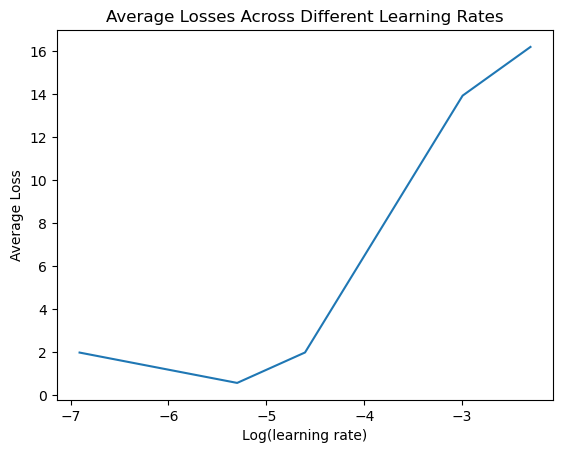

In [207]:
loss_ppl_across_lr = avg_losses_ppl_df[(avg_losses_ppl_df['epoch']==11)]
avg_losses_lr = []
avg_ppl_lr = []
for lr in learning_rates:
    avg_losses_lr.append(np.mean(loss_ppl_across_lr[loss_ppl_across_lr['learning_rate']==lr]['Avg_Loss'].values))
    avg_ppl_lr.append(np.mean(loss_ppl_across_lr[loss_ppl_across_lr['learning_rate']==lr]['Avg_PPL'].values))

plt.plot(torch.log(torch.Tensor(learning_rates)), avg_losses_lr)
plt.xlabel('Log(learning rate)')
plt.ylabel('Average Loss')
plt.title('Average Losses Across Different Learning Rates')
plt.show()

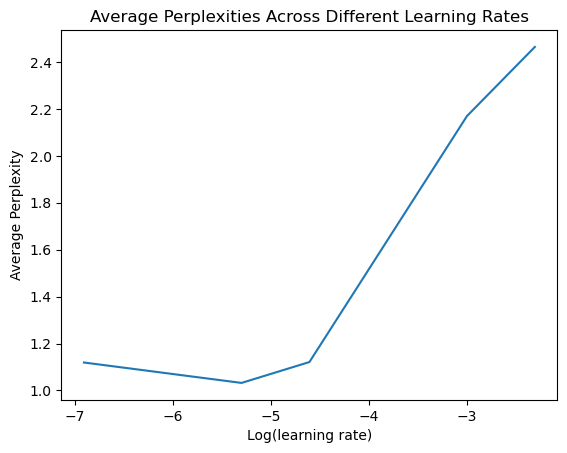

In [208]:
plt.plot(torch.log(torch.Tensor(learning_rates)), avg_ppl_lr)
plt.xlabel('Log(learning rate)')
plt.ylabel('Average Perplexity')
plt.title('Average Perplexities Across Different Learning Rates')
plt.show()

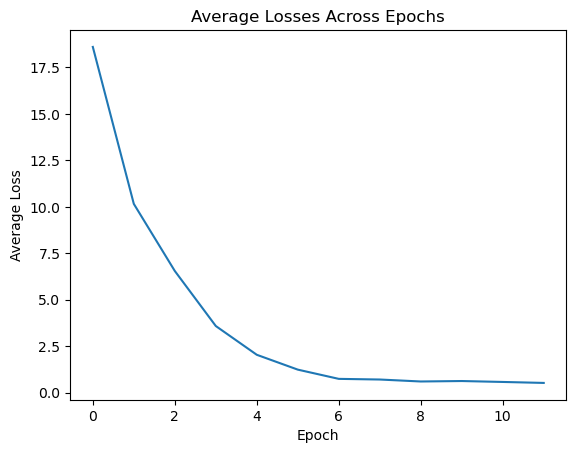

In [209]:
loss_ppl_across_epoch = avg_losses_ppl_df[(avg_losses_ppl_df['learning_rate']==0.005) & 
                                          (avg_losses_ppl_df['hidden_dim']==200) &
                                          (avg_losses_ppl_df['batch_size']==150)]

plt.plot(loss_ppl_across_epoch['epoch'], loss_ppl_across_epoch['Avg_Loss'])
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
plt.title('Average Losses Across Epochs')
plt.show()

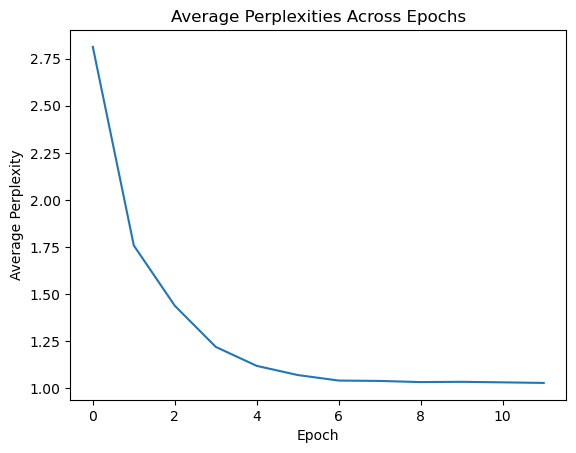

In [219]:
plt.plot(loss_ppl_across_epoch['epoch'], loss_ppl_across_epoch['Avg_PPL'])
plt.xlabel('Epoch')
plt.ylabel('Average Perplexity')
plt.title('Average Perplexities Across Epochs')
plt.show()

As we can see from the two plots above that the marginal gain on minimizing average loss and perplexity by adding more epochs has become very little when the number of epochs reaches 7 (shown as 6 because it was 0-indexed).

<Axes: xlabel='batch_size', ylabel='hidden_dim'>

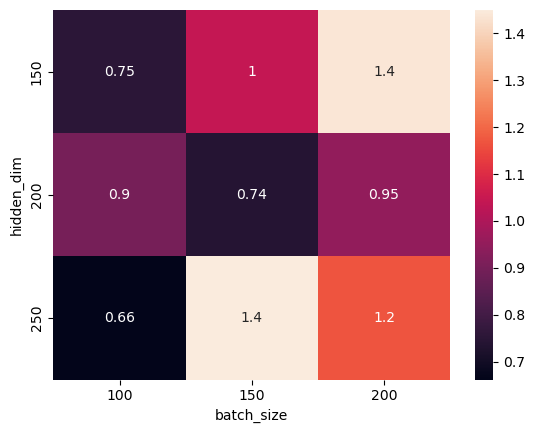

In [227]:
loss_across_hd_bs = avg_losses_ppl_df[(avg_losses_ppl_df['learning_rate']==0.005) & 
                                      (avg_losses_ppl_df['epoch']==6)]

sns.heatmap(loss_across_hd_bs.pivot(index="hidden_dim", columns="batch_size", values="Avg_Loss"), annot=True)

In [228]:
loss_across_hd_bs.pivot(index="hidden_dim", columns="batch_size", values="Avg_PPL")

batch_size,100,150,200
hidden_dim,,,
150,1.042641,1.059570,1.083167
200,1.051235,1.041968,1.054144
250,1.037444,1.083883,1.067003


As shown in the heatmap above, when learning rate and the number of epochs equal 0.005 and 9 respectively, the optimal values for batch size and hidden dimensions were 100 and 250 respectively.

In [232]:
# Final selected Hyper-parameters
embed_size=100
hidden_size=250
batch_size = 100
clip_grad = 5
log_every_n_iter = 100
max_epoch = 7
uniform_init_param = 0.1
lr = 0.005



In [ ]:
nmt_model = NMT(embed_size, hidden_size, frword_to_int, enword_to_int, 
                int_to_frword, int_to_enword, False)

In [233]:
trained_nmt_model,_,_ = train_nmt(nmt_model, train_fr_int_sents, train_en_int_sents, frword_to_int, batch_size, clip_grad, 
                                  log_every_n_iter, max_epoch, uniform_init_param, lr)

uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 28.40, avg. ppl 4.84 cum. examples 10000, time elapsed 58.20 sec
epoch 1, iter 200, avg. loss 14.16, avg. ppl 2.20 cum. examples 20000, time elapsed 80.89 sec
epoch 1, iter 300, avg. loss 12.55, avg. ppl 2.01 cum. examples 30000, time elapsed 101.76 sec
epoch 1, iter 400, avg. loss 10.81, avg. ppl 1.82 cum. examples 40000, time elapsed 140.88 sec
16.479355654907227
epoch 2, iter 500, avg. loss 10.00, avg. ppl 1.74 cum. examples 50000, time elapsed 179.97 sec
epoch 2, iter 600, avg. loss 9.64, avg. ppl 1.71 cum. examples 60000, time elapsed 227.29 sec
epoch 2, iter 700, avg. loss 9.38, avg. ppl 1.68 cum. examples 70000, time elapsed 271.16 sec
epoch 2, iter 800, avg. loss 9.11, avg. ppl 1.66 cum. examples 80000, time elapsed 307.83 sec
9.533130299377442
epoch 3, iter 900, avg. loss 8.79, avg. ppl 1.63 cum. examples 90000, time elapsed 363.28 sec
epoch 3, iter 100

In [235]:
nmt_attn_model = NMT(embed_size, hidden_size, frword_to_int, enword_to_int, 
                 int_to_frword, int_to_enword, True)

trained_nmt_attn_model,_,_ = train_nmt(nmt_attn_model, train_fr_int_sents, train_en_int_sents, frword_to_int, batch_size, clip_grad,
                                   log_every_n_iter, max_epoch, uniform_init_param, lr)

uniformly initialize parameters [-0.100000, +0.100000]
begin Maximum Neg-Log-Likelihood training
epoch 1, iter 100, avg. loss 26.83, avg. ppl 4.44 cum. examples 10000, time elapsed 71.31 sec
epoch 1, iter 200, avg. loss 6.85, avg. ppl 1.46 cum. examples 20000, time elapsed 127.60 sec
epoch 1, iter 300, avg. loss 1.62, avg. ppl 1.09 cum. examples 30000, time elapsed 210.78 sec
epoch 1, iter 400, avg. loss 1.17, avg. ppl 1.07 cum. examples 40000, time elapsed 288.69 sec
epoch 2, iter 500, avg. loss 1.00, avg. ppl 1.06 cum. examples 50000, time elapsed 350.99 sec
epoch 2, iter 600, avg. loss 0.81, avg. ppl 1.05 cum. examples 60000, time elapsed 408.21 sec
epoch 2, iter 700, avg. loss 0.78, avg. ppl 1.04 cum. examples 70000, time elapsed 498.59 sec
epoch 2, iter 800, avg. loss 0.75, avg. ppl 1.04 cum. examples 80000, time elapsed 588.28 sec
epoch 3, iter 900, avg. loss 0.68, avg. ppl 1.04 cum. examples 90000, time elapsed 688.53 sec
epoch 3, iter 1000, avg. loss 0.63, avg. ppl 1.04 cum. ex

Code for saving or loading trained model

In [251]:
#params = {'args': {'embed_size':trained_nmt_model.model_embeddings.embed_size, 'hidden_size':trained_nmt_model.hidden_size, 
#                   'use_attention': trained_nmt_model.use_attention},
#          'src_vocab_to_int': trained_nmt_model.src_vocab_to_int, 'tgt_vocab_to_int': trained_nmt_model.tgt_vocab_to_int, 
#          'int_to_src_vocab': trained_nmt_model.int_to_src_vocab, 'int_to_tgt_vocab': trained_nmt_model.int_to_tgt_vocab, 
#          'state_dict': trained_nmt_model.state_dict()}
#path = './trained_nmt_model.pt'
#torch.save(params, path)

In [252]:
#params = {'args': {'embed_size':trained_nmt_attn_model.model_embeddings.embed_size, 'hidden_size':trained_nmt_attn_model.hidden_size, 
#                   'use_attention': trained_nmt_attn_model.use_attention},
#          'src_vocab_to_int': trained_nmt_attn_model.src_vocab_to_int, 'tgt_vocab_to_int': trained_nmt_attn_model.tgt_vocab_to_int, 
#          'int_to_src_vocab': trained_nmt_attn_model.int_to_src_vocab, 'int_to_tgt_vocab': trained_nmt_attn_model.int_to_tgt_vocab, 
#          'state_dict': trained_nmt_attn_model.state_dict()}
#path = './trained_nmt_attn_model.pt'
#torch.save(params, path)

In [253]:
#model_path = './trained_nmt_model.pt'
#params = torch.load(model_path, map_location=lambda storage, loc: storage)
#args = params['args']
#bu_nmt_model = NMT(src_vocab_to_int=params['src_vocab_to_int'], tgt_vocab_to_int=params['tgt_vocab_to_int'], 
#                   int_to_src_vocab=params['int_to_src_vocab'], int_to_tgt_vocab=params['int_to_tgt_vocab'],**args)
#bu_nmt_model.load_state_dict(params['state_dict'])

<All keys matched successfully>

In [254]:
#model_path = './trained_nmt_attn_model.pt'
#params = torch.load(model_path, map_location=lambda storage, loc: storage)
#args = params['args']
#bu_nmt_attn_model = NMT(src_vocab_to_int=params['src_vocab_to_int'], tgt_vocab_to_int=params['tgt_vocab_to_int'], 
#                   int_to_src_vocab=params['int_to_src_vocab'], int_to_tgt_vocab=params['int_to_tgt_vocab'],**args)
#bu_nmt_attn_model.load_state_dict(params['state_dict'])

<All keys matched successfully>

Functions that will be used for decoding/translating and computing BLEU scores

In [236]:
def beam_search(model: NMT, test_data_src: List[List[int]], beam_size: int, max_decoding_time_step: int) -> List[List[Hypothesis]]:
    """ 
    Function to perform beam search to construct hypotheses for source sentences.
    
    Parameters:
    model NMT: NMT Model
    test_data_src list(list(int)): List of sentences of source language in their numerical(int) form, from test set.
    beam_size int: beam_size (number of hypotheses to hold for a translation at every step)
    max_decoding_time_step int: maximum sentence length that Beam search can produce
    
    Output:
    hypotheses list(list(Hypothesis)): List of Hypothesis translations for every source sentence.
    """
    was_training = model.training
    # Turn the model to eval mode to prevent the gradient flowing
    model.eval()

    hypotheses = []
    with torch.no_grad():
        for src_sent in test_data_src:
            sample_hypos = model.beam_search(src_sent, beam_size=beam_size, max_decoding_time_step=max_decoding_time_step)

            hypotheses.append(sample_hypos)

    if was_training: model.train(was_training)

    return hypotheses

In [237]:
def corpus_level_bleu_score(references: List[List[str]], hypotheses: List[Hypothesis]) -> float:
    """ 
    Function to compute corpus-level BLEU score, given translation results and groud-truth target sentences
    
    Parameters:
    references (List[List[str]]): a list of groud-truth target sentences
    hypotheses (List[Hypothesis]): a list of hypotheses, one for each target sentence
    
    Outputs:
    bleu_score float: corpus-level BLEU score computed using nltk.translate.bleu_score.corpus_bleu
    """
    if references[0][0] == '<s>':
        references = [ref[1:-1] for ref in references]
    bleu_score = corpus_bleu([[ref] for ref in references],
                             [hyp.value for hyp in hypotheses])
    return bleu_score

In [238]:
def decode(model:NMT, test_data_src, test_data_tgt, int_to_tgt_vocab, beam_size, max_decoding_time_step):
    """ 
    Function to performs decoding/translation on a test set, and save the best-scoring decoding results.
    Also computes corpus-level BLEU score when the groud-truth target sentences are given.
    
    Parameters:
    model NMT: NMT Model
    test_data_src list(list(int)): List of sentences of source language in their numerical(int) form, from test set. 
    test_data_tgt list(list(int)): List of sentences of target language in their numerical(int) form, from test set.(the ground-truth) 
    int_to_tgt_vocab dict(int:str): Look up table from int to word of the target sentences' vocab
    beam_size int: beam_size (number of hypotheses to hold for a translation at every step)
    max_decoding_time_step int: maximum sentence length that Beam search can produce
    
    Outputs:
    top_hypotheses list(Hypothesis): the best-scoring decoding results from hypotheses of beam search
    bleu_score float: corpus-level BLEU score of the best-scoring decoding results
    """
    # Perform beam search to get hypotheses
    hypotheses = beam_search(model, test_data_src, beam_size=beam_size,
                             max_decoding_time_step=max_decoding_time_step)
    
    # Turn numerical test data into list(list(str)) for later use to compute BLEU score
    test_data_tgt_words = []
    for sent in test_data_tgt:
        sent_words = [int_to_tgt_vocab[num] for num in sent]
        test_data_tgt_words.append(sent_words)
    
    # Get the best-scoring hypos. and compute the BLEU score
    top_hypotheses = [hyps[0] for hyps in hypotheses]
    bleu_score = corpus_level_bleu_score(test_data_tgt_words, top_hypotheses)
    print('Corpus BLEU: {}'.format(bleu_score * 100))

    return top_hypotheses, bleu_score

In [255]:
top_hypo_without_attn, bleu_score_without_attn = decode(bu_nmt_model, test_fr_int_sents, test_en_int_sents, int_to_enword, 5, 70)

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder hidden size: torch.Size([5, 250])
Decoder output size: torch.Size([5

In [256]:
top_hypo_with_attn, bleu_score_with_attn = decode(bu_nmt_attn_model, test_fr_int_sents, test_en_int_sents, int_to_enword, 5, 70)

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([4, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5

Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([3, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([5, 250])
Decoder output size: torch.Size([2, 250])
Decoder output size: torch.Size([1, 250])
Decoder output size: torch.Size([1

In [257]:
bleu_score_without_attn

0.6360343394572334

In [258]:
bleu_score_with_attn

0.7050389462272547